# Assignment 5 - Keyboard Optimisation
By Nishanth Senthil Kumar (EE23B049)

## Some instructions before running this code
Please ensure that the input layouts for the keyboards are given as a python script(i.e a file with a .py extension), with the input dictionaries being named "keys" and "dictionaries" respectively. This script has to be present in the same directory.

Please also ensure that matplotlib, random and copy are installed in your system before running it, if not please install it using pip (Note : All these libraries are there in the virtual juypter server hosted by sir)

Please run all the cells sequentially, if you change the input string, please run the whole program again to avoid any issues.

The last cell of this program generates an animation, if "num_iterations" is 100, it takes around 25 seconds to generate. 
If for some reason it takes a long time to generate, end the excecution and you will be able to view the final layout and final graph of the variation of the minimum distance with time. 

The optimised and the initial distance are printed at the end of the last cell of the notebook. 

Please also ensure that the "layout.py" file is present in the same directory as this notebook, and run it only then. 
If you wish to, you can use "colemak.py" (present in the zip file) instead of "layout.py", rename it to "layout.py" and use it or copy paste its contents to "layout.py"

Importing the necessary libraries

In [1]:
import matplotlib.pyplot as plt
import matplotlib.patches as patches 
import numpy as np
from matplotlib import cm
from matplotlib.colors import Normalize
import matplotlib.colors 
import random
import copy
from matplotlib.animation import FuncAnimation

The "layout.py" file is a python file that contains the input dictionaries, "keys" and "characters", The are required to be named the same, and make sure to run this code only if the "layout.py" file is present in the same directory as this python notebook.

The input string is declared here, feel free to change it 

In [2]:
import layout as layout
keys=layout.keys
characters=layout.characters
initial_keys=keys

input_string= '''COULDN'T PRONOUNCE THE NAME EITHER?Don't sweat it-what matters is having an AMAZING time with us! We're SUPER EXCITED to invite you to SHAASTRA'S SOCIAL CAMPAIGN LAUNCH on SUNDAY, 29TH SEPTEMBER, at 6:30 PM, happening at the HFC LAWNS!Get ready for an evening packed with FUN ACTIVITIES, GAMES, and a chance to be part of something BIG! Whether you're coming for the FUN or to support the CAUSE, it's going to be a NIGHT TO REMEMBER!Grab your friends, and LET'S MAKE IT EPIC! See you there!'''

This snippet is taken from "Assignment 4", I am fixing the height and width of the keys (read Assignment 4 README file), and I find the dimensions across which the keyboard layout is spread, which will be used in plotting. 

I am assuming that all the coordinates are positive and wont exceed the value of 1e9

In [3]:
key_width=1
key_height=1

x_min=1e9
x_max=0
y_min=1e9
y_max=0

#Finding the maximum and minimum values of the x and y coords in the layout file
for key in keys:
    x=keys[key]['pos'][0]
    y=keys[key]['pos'][1]
    if(x<x_min):
        x_min=x
    if(y<y_min):
        y_min=y
    if(x>x_max):
        x_max=x
    if(y>y_max):
        y_max=y

This function updates the heatmap dictionary, this was taken from my 'Assignment 4' submission, for more detailed explanation, please refer my Assignment 4 README file. 

Note : One modification that I have made for this assignment is ignoring space characters and usage of the space bar. 

In [4]:
def update_heatmap(input_string):
    '''
    Input : The input string given by user
    Description : This function goes through the input string and updates the heatmap dictionary 
    with frequencies of each charater that is being typed. 
    Note : If a character that is not present in the layout, or a character whose mapping has not been given in the layout
    is present in the input string, it will raise a valueerror with the character at fault. If so, please check your input dictionaries. 
    '''
    heatmap=dict()
    for key in keys:
        heatmap[key]=0

    for char in input_string:

        #skipping the space character.
        if(char==' '):
            continue

        if(char in keys):
            heatmap[char]+=1
            
        elif(char in characters):
            for i in characters[char]:
                heatmap[i]+=1
    
        else:
            raise ValueError(f"Invalid character {char}, Please check your input layout and add the required character and their mapping")

    return heatmap

This function does the distance calculations, this is done as per sir's convention that was followed in programming quiz 4. This function was also taken from my 'Assignment 4' submission. Again as stated earlier, usage of space bar is ignored in this assignment. 

In [5]:
def distance_calculation(input_string,keys):
    '''
    Input : The input string given by user
    Description : This function calculates the distance travelled by the fingers from the home keys, if the key requires more than
    one key to be pressed, it will access the characters dictionary and find the mapping.
    If the entered characters is not defined in either the "keys" or "characters", ValueError will be thown
    '''

    distance_travelled=0

    for char in input_string:

        #I am skipping 'Space' keys in the distance calculation
        if(char==' '):
            continue

        if(char in keys):
            char_position=keys[char]['pos']
            home_key=keys[char]['start']
            home_position=keys[home_key]['pos']
            distance_travelled+=((char_position[0]-home_position[0])**2 + (char_position[1]-home_position[1])**2)**0.5

        elif(char in characters):
            for i in characters[char]:
                char_position=keys[i]['pos']
                home_key=keys[i]['start']
                home_position=keys[home_key]['pos']
                distance_travelled+=((char_position[0]-home_position[0])**2 + (char_position[1]-home_position[1])**2)**0.5
        
        else:
            raise ValueError(f"Invalid character {char}, Please check your input layout and add the required character and their mapping")

    return distance_travelled

I am generating 2 lists, one with the initial home keys (The home keys before any optimisations), and the other one having all the keys that are used in the layout. 

I also remove 'space' from the list of keys, as I am ignoring them for this optimisation problem. 

In [6]:
initial_home_keys=set()
for key in keys:
    initial_home_keys.add(keys[key]['start'])

initial_home_keys=list(initial_home_keys)

list_of_keys=list(keys.keys())
#removing the space bar
list_of_keys.remove('Space')

Function to swap keys in the dictionary "in-place"

In [7]:
def swap_keys(guess_key_1, guess_key_2, current_layout, initial_home_keys):
    '''
    Inputs : Two randomly generated keys that will be swapped, the current layout and the initial home keys.
    Description : This function modifies the input dictionary, the 2 keys get interchanged, In case if one of the generated keys 
    is a home row key, the function first compares with a "home keys" list, verifies that it is a home key, and adds the new key to the home 
    row key list. The old home row key gets deleted, and the new key replaces the old home key where is is to be replaced.
    Output : Returns the new dictionary and the new list of home keys after the swap. 
    '''
    
    keys = copy.deepcopy(current_layout)  
    
    # Swap the two keys in the layout
    temp = keys[guess_key_1]
    keys[guess_key_1] = keys[guess_key_2]
    keys[guess_key_2] = temp
    
    new_home_keys = copy.deepcopy(initial_home_keys)


    # If guess_key_1 is in home keys, update the 'start' of related keys and swap in home keys
    if guess_key_1 in initial_home_keys:
        new_home_keys.remove(guess_key_1)
        new_home_keys.append(guess_key_2)
        for key in keys:
            if keys[key]['start'] == guess_key_1:
                keys[key]['start'] = guess_key_2
        

    # If guess_key_2 is in home keys, update the 'start' of related keys and swap in home keys
    if guess_key_2 in initial_home_keys:
        new_home_keys.remove(guess_key_2)
        new_home_keys.append(guess_key_1)
        for key in keys:
            if keys[key]['start'] == guess_key_2:
                keys[key]['start'] = guess_key_1
        

    # Return the updated keys and the modified home keys
    return keys, new_home_keys

This is similar to the Travelling Salesman Problem, where instead of reordering the route, we are changing the layout by swapping the keys

In [8]:
def get_neighbour(current_layout,initial_home_keys):
    '''
    Input: The current layout dictionary, and the home keys list"
    Description: Generates 2 random keys from the "list_of_keys" list, and calls the swap function which modifies the layout dictionary.
    Output: Returns the new layout, and the new list of home row keys, which was returned from the "swap_keys" function. 
    '''
    i,j=random.sample(list_of_keys,2)
    new_layout,new_home_keys=swap_keys(str(i),str(j),current_layout,initial_home_keys)
    return new_layout,new_home_keys

This is the function that does the simulated annealing, 

In [9]:
def simulated_annealing(initial_home_keys,initial_temp,cooling_rate,num_iterations):
    '''
    Input : The initial home keys list, the initial temperature paramater, cooling rate parameter, and the number of iterations paramater.
    Description : This function does the simulated annealing, inspired from Sir's code.  We are optimising for the distance travelled
    by the fingers. 
    Output: Lists of best_layouts, best_distances and distances
    '''
    current_layout=keys
    current_distance=distance_calculation(input_string,keys)

    best_layout=(copy.deepcopy(current_layout))
    best_distance=current_distance

    #initialising the return dictionaries
    temp=initial_temp
    distances=[current_distance]
    best_layouts=[copy.deepcopy(current_layout)]
    best_distances=[best_distance]

    for i in range(num_iterations):
        neighbour_layout,initial_home_keys=get_neighbour(current_layout,initial_home_keys)
        neighbour_distance=distance_calculation(input_string,neighbour_layout)

        #finding the probability and checking if it is a more optimal solution
        p = np.exp((current_distance - neighbour_distance) / temp)
        if neighbour_distance < current_distance or random.random() < p:
            current_layout = neighbour_layout
            current_distance = neighbour_distance
            
            if current_distance < best_distance:
                best_layout = copy.deepcopy(current_layout)
                best_distance = current_distance

        #updating the temp and the lists with the optimal quantities
        temp *= cooling_rate
        distances.append(current_distance)
        best_layouts.append(copy.deepcopy(best_layout))
        best_distances.append(best_distance)

    return best_layouts, best_distances, distances
        

This is the update function that is given as an argument to the animation. If f frames have been completed, it shows f points of the 
data in the next frame of animation, and when it is joined together on video, it appears like an animation of the data.

In [10]:
def update(frame,distances, cur_dist,distance_line, cur_dist_line):
    distance_line.set_data(range(frame + 1), distances[:frame + 1])
    cur_dist_line.set_data(range(frame + 1), cur_dist[:frame + 1])
    return distance_line, cur_dist_line

Main function optimises the layout, generates an animation of the distance travelled decreasing with time, and also the final graph of the minimum distance changing over time and the final keyboard layout. 

I did not include the animation of the keyboard layout changing with time as the size of the animation becomes big, and the time taken to generate the animation becomes too long.

For 100 iterations, with only the distance animation, the animation takes around 25 seconds to generate.

Please wait for around 25 seconds after running the code to view the animation. 

If for some reason it takes too long, stop the code, and you can view the final keyboard layout and the graph of the minimum distances with time. 

If you want better optimisations, increase the number of iterations. 

The code for generating the keyboard layout is taken from my assignment 4 submission. Please read its README file for more information. 

In [11]:
# Main function to run the algorithm and create the animation
def main():

    #initial conditions of the parameters, for better results, increase num_iterations, but the animation will not work. 
    initial_temp = 100
    cooling_rate = 0.985
    num_iterations = 80

    #running the simulated annealing function
    best_layout, best_distances, cur_dist = simulated_annealing(initial_home_keys,initial_temp, cooling_rate, num_iterations)
    
    heatmap=update_heatmap(input_string)
    initial_answer=distance_calculation(input_string,initial_keys)
    optimal_answer=min(best_distances)
    
    #finding the index corresponding to the best distance, and using that layout to plot the final keyboard layout. 
    index=0
    for i in range(len(best_distances)):
        if(best_distances[i]==optimal_answer):
            index=i
    keys=best_layout[index]

    print("Initial Distance",initial_answer)
    print("Optimised Distance",optimal_answer)
    #checking for divide by 0 error
    if(initial_answer!=0):
        print("Percentage Optimisation is",100*(initial_answer-optimal_answer)/initial_answer,"%")
    print("Generating animation...    Please wait (30-40 secs)")
    print("Ignore animation size warnings if present")

    # Set up the figure and subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(30,10))
    fig.suptitle("Optimising keyboard Layout using Simulated Annealing", fontsize=22)

    #Generating ax1 is from 'Assignment 4' please refer to that code and documentation for more details. 
    
    max_hits = max(heatmap.values())
    min_hits = min(heatmap.values())
    
    norm = Normalize(vmin=min_hits, vmax=max_hits)
    cmap = cm.gist_rainbow

    def get_color(value, min_hits, max_hits):
        '''
        Input : value - frequency corresponding to the key
                min_hits - Minimum no of presses among all keys
                max_hist - Maximum no of presses among all keys
        Description : This function allots a color on the bottom half of the gist_rainbow colormap based on the no of times the key was pressed
        If the key was never pressed, I return white, which is the background of the keyboard. 
        Since I want only the bottom half of gist_rainbow, I normalise between 0 and 0.4.
        Returns : Array corresponding to the color it should have from the color map
        '''
        if value == 0:
            return (1, 1, 1)
        else:
            if max_hits != min_hits:
                norm_value = (value - min_hits) / (max_hits - min_hits)
                norm_value = 0.4 - norm_value * (0.4 - 0)
            else:
                norm_value = 0

            norm_value = np.clip(norm_value, 0, 0.4)
            return cmap(norm_value)

    key_coords = []
    key_colors = []
    
    #plotting the keyboard characters
    for key in keys:
        x = keys[key]['pos'][0]
        y = keys[key]['pos'][1]
        key_clean = key.strip()
        
        #this gets the color corresponding to the frequency of the character from the colormap
        base_color = get_color(heatmap.get(key_clean, 0), min_hits, max_hits)[:3]
        base_color = np.array(base_color).reshape(1, 1, 3)

        #The bg color of each key is white, so at the distance from the centre increaes, I want to make it fade into white
        #I use a gaussian filter to mix the base_color with white as the distance increases(learnt this in EE1103).
        #It generates a gradient_color matrix which is used by imshow to plot the colors
        x_grid, y_grid = np.meshgrid(np.linspace(-1, 1, 100), np.linspace(-1, 1, 100))
        r = np.sqrt(x_grid**2 + y_grid**2)
        z = np.exp(-3 * r / 2).reshape(100, 100, 1)
        gradient_color = z * base_color + (1 - z) * np.array([1, 1, 1]).reshape(1, 1, 3)

        ax1.imshow(gradient_color, extent=[x, x + key_width, y, y + key_height], aspect='auto')

        rect = patches.FancyBboxPatch((x, y), key_width, key_height, boxstyle="round,pad=0.001", 
                                      linewidth=1.5, edgecolor='black', facecolor='none')
        ax1.add_patch(rect)
        ax1.text(x + key_width / 2, y + key_height / 2, key.strip(), 
                 fontsize=12, ha='center', va='center', color='black')
        
        key_coords.append([x + key_width / 2, y + key_height / 2])
        key_colors.append(heatmap.get(key_clean, 0))

    ax1.set_xlim(0, 15)
    ax1.set_ylim(-3, 10)
    ax1.set_title("Final Optimised Keyboard Layout", fontsize=20)
    ax1.axis('off')


    #Since i am using only a part of gist_rainbow, I couldnt find a way to have a colorbar with only those values, so I made a custom colormap to make the colorbar
    custom_cmap = matplotlib.colors.LinearSegmentedColormap.from_list(
        "custom", ["white", "lightgreen", "yellow", "orange", "red"])
    sm = plt.cm.ScalarMappable(cmap=custom_cmap, norm=norm)
    fig.colorbar(sm, ax=ax1, orientation='vertical', label='Key Press Frequency')

    
    # Distance subplot
    ax2.set_xlim(0, num_iterations)
    ax2.set_ylim(min(best_distances) * 0.9, max(best_distances) * 1.1)
    ax2.set_title("Best Distance over Iterations",fontsize=20)
    ax2.set_xlabel("Iteration")
    ax2.set_ylabel("Distance")
    distance_line, = ax2.plot([], [], 'r-')
    cur_dist_line, = ax2.plot([], [], 'g-')

    # Create the animation
    anim = FuncAnimation(fig, update, frames=range(0, num_iterations, 1), 
                         fargs=(best_distances, cur_dist, distance_line, cur_dist_line),
                         interval=50, blit=True, repeat=False)
    return anim

Note that there may be some animation size warnings, please ignore them, and the animated plot will have details till around the 90th iteration.

Initial Distance 726.8933113486888
Optimised Distance 675.8960330381632
Percentage Optimisation is 7.015785881411472 %
Generating animation...    Please wait (30-40 secs)
Ignore animation size warnings if present


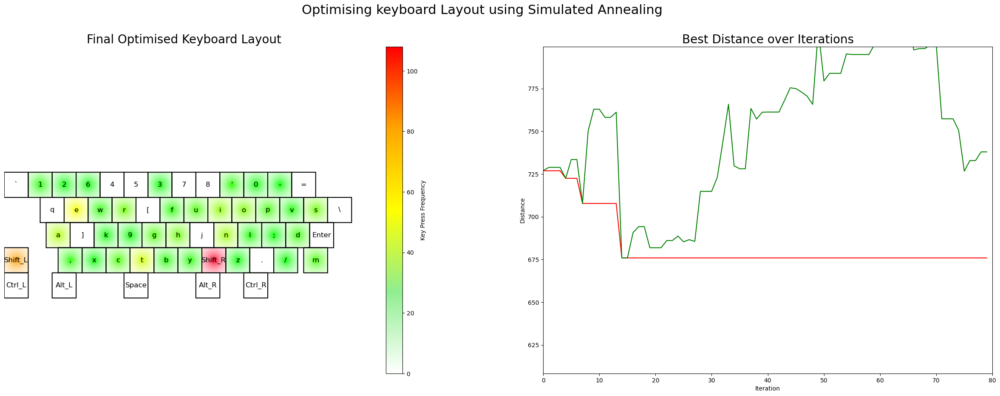

In [12]:
#generating the animation
anim = main()
from IPython.display import HTML
HTML(anim.to_jshtml())
